In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("ravindrasinghrana/job-description-dataset")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/job-description-dataset


In [ ]:
!pip install folium geopy wordcloud

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.4/113.4 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.4/125.4 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 539.2/539.2 kB 20.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.7/40.7 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.4/90.4 kB 8.9 MB/s eta 0:00:00


In [ ]:
# Cell 1: Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import folium
from geopy.geocoders import Nominatim
from wordcloud import WordCloud, STOPWORDS
from sklearn.preprocessing import LabelEncoder
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Set plotting style
plt.style.use('default')
sns.set_palette("husl")
%matplotlib inline

In [ ]:
# Cell 2: Load and explore the data
df = pd.read_csv(f'{path}/job_descriptions.csv')
print(f"Dataset shape: {df.shape}")
print("\nColumns:", df.columns.tolist())
print("\nData types:\n", df.dtypes)
print("\nMissing values:\n", df.isnull().sum())

Dataset shape: (1615940, 23)

Columns: ['Job Id', 'Experience', 'Qualifications', 'Salary Range', 'location', 'Country', 'latitude', 'longitude', 'Work Type', 'Company Size', 'Job Posting Date', 'Preference', 'Contact Person', 'Contact', 'Job Title', 'Role', 'Job Portal', 'Job Description', 'Benefits', 'skills', 'Responsibilities', 'Company', 'Company Profile']

Data types:
 Job Id                int64
Experience           object
Qualifications       object
Salary Range         object
location             object
Country              object
latitude            float64
longitude           float64
Work Type            object
Company Size          int64
Job Posting Date     object
Preference           object
Contact Person       object
Contact              object
Job Title            object
Role                 object
Job Portal           object
Job Description      object
Benefits             object
skills               object
Responsibilities     object
Company              object
Compan

In [ ]:
# # Cell 3: Data cleaning and preprocessing
# # Drop the first column (appears to be index)
# df = df.drop(columns=['Unnamed: 0'])

# Convert salary range to numeric values
def extract_salary(salary_str):
    if isinstance(salary_str, str) and 'K' in salary_str:
        try:
            min_sal, max_sal = salary_str.replace('$', '').replace('K', '').split('-')
            return (float(min_sal) + float(max_sal)) / 2
        except:
            return None
    return None

df['Avg_Salary'] = df['Salary Range'].apply(extract_salary)

# Extract min and max salary
def extract_min_salary(salary_str):
    if isinstance(salary_str, str) and 'K' in salary_str:
        try:
            min_sal = salary_str.replace('$', '').replace('K', '').split('-')[0]
            return float(min_sal)
        except:
            return None
    return None

def extract_max_salary(salary_str):
    if isinstance(salary_str, str) and 'K' in salary_str:
        try:
            max_sal = salary_str.replace('$', '').replace('K', '').split('-')[1]
            return float(max_sal)
        except:
            return None
    return None

df['Min_Salary'] = df['Salary Range'].apply(extract_min_salary)
df['Max_Salary'] = df['Salary Range'].apply(extract_max_salary)
df['Salary_Range_Width'] = df['Max_Salary'] - df['Min_Salary']

# Convert experience to numeric
def extract_experience(exp_str):
    if isinstance(exp_str, str) and 'Years' in exp_str:
        try:
            parts = exp_str.split(' to ')
            min_exp = float(parts[0])
            max_exp = float(parts[1].replace(' Years', ''))
            return (min_exp + max_exp) / 2
        except:
            return None
    return None

df['Avg_Experience'] = df['Experience'].apply(extract_experience)

# Extract min and max experience
def extract_min_experience(exp_str):
    if isinstance(exp_str, str) and 'Years' in exp_str:
        try:
            return float(exp_str.split(' to ')[0])
        except:
            return None
    return None

def extract_max_experience(exp_str):
    if isinstance(exp_str, str) and 'Years' in exp_str:
        try:
            return float(exp_str.split(' to ')[1].replace(' Years', ''))
        except:
            return None
    return None

df['Min_Experience'] = df['Experience'].apply(extract_min_experience)
df['Max_Experience'] = df['Experience'].apply(extract_max_experience)

# Convert date to datetime
df['Job Posting Date'] = pd.to_datetime(df['Job Posting Date'])

# Extract year and month
df['Year'] = df['Job Posting Date'].dt.year
df['Month'] = df['Job Posting Date'].dt.month
df['Month_Name'] = df['Job Posting Date'].dt.month_name()


In [ ]:
# Cell 4: Basic statistics and overview
print("Basic Statistics:")
print(f"Total jobs: {len(df)}")
print(f"Time range: {df['Job Posting Date'].min()} to {df['Job Posting Date'].max()}")
print(f"Unique countries: {df['Country'].nunique()}")
print(f"Unique job titles: {df['Job Title'].nunique()}")
print(f"Unique companies: {df['Company'].nunique()}")

print("\nSalary Statistics:")
print(f"Average salary: ${df['Avg_Salary'].mean():.2f}K")
print(f"Min salary: ${df['Min_Salary'].min():.2f}K")
print(f"Max salary: ${df['Max_Salary'].max():.2f}K")

print("\nExperience Statistics:")
print(f"Average experience: {df['Avg_Experience'].mean():.2f} years")
print(f"Min experience: {df['Min_Experience'].min():.2f} years")
print(f"Max experience: {df['Max_Experience'].max():.2f} years")


Basic Statistics:
Total jobs: 1615940
Time range: 2021-09-15 00:00:00 to 2023-09-15 00:00:00
Unique countries: 216
Unique job titles: 147
Unique companies: 888

Salary Statistics:
Average salary: $82.49K
Min salary: $55.00K
Max salary: $130.00K

Experience Statistics:
Average experience: 7.00 years
Min experience: 0.00 years
Max experience: 15.00 years


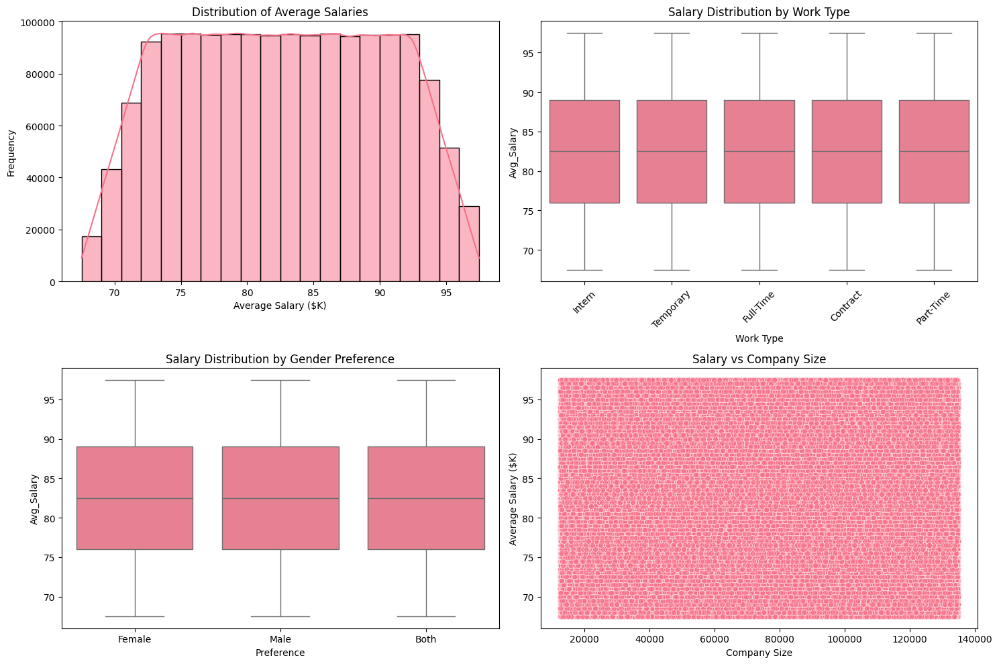

In [ ]:
# Cell 5: Salary distribution visualization
plt.figure(figsize=(15, 10))

# Salary distribution
plt.subplot(2, 2, 1)
sns.histplot(df['Avg_Salary'], bins=20, kde=True)
plt.title('Distribution of Average Salaries')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Frequency')

# Salary by work type
plt.subplot(2, 2, 2)
sns.boxplot(x='Work Type', y='Avg_Salary', data=df)
plt.title('Salary Distribution by Work Type')
plt.xticks(rotation=45)

# Salary by preference
plt.subplot(2, 2, 3)
sns.boxplot(x='Preference', y='Avg_Salary', data=df)
plt.title('Salary Distribution by Gender Preference')

# Salary by company size
plt.subplot(2, 2, 4)
sns.scatterplot(x='Company Size', y='Avg_Salary', data=df, alpha=0.6)
plt.title('Salary vs Company Size')
plt.xlabel('Company Size')
plt.ylabel('Average Salary ($K)')

plt.tight_layout()
plt.show()


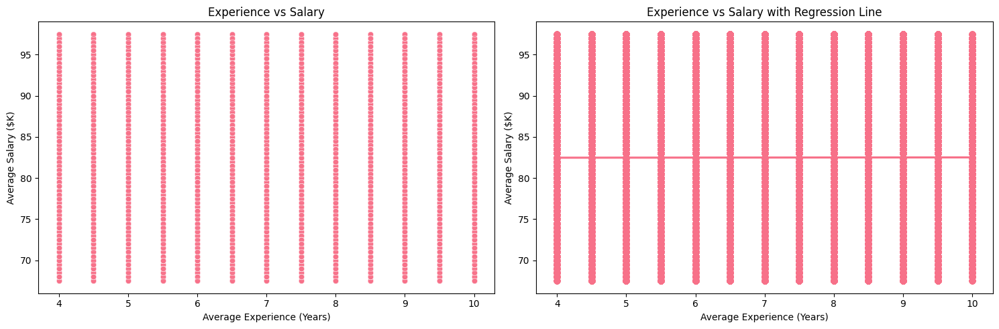

In [ ]:
# Cell 6: Experience vs Salary analysis
plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
sns.scatterplot(x='Avg_Experience', y='Avg_Salary', data=df, alpha=0.6)
plt.title('Experience vs Salary')
plt.xlabel('Average Experience (Years)')
plt.ylabel('Average Salary ($K)')

plt.subplot(1, 2, 2)
sns.regplot(x='Avg_Experience', y='Avg_Salary', data=df, scatter_kws={'alpha':0.3})
plt.title('Experience vs Salary with Regression Line')
plt.xlabel('Average Experience (Years)')
plt.ylabel('Average Salary ($K)')

plt.tight_layout()
plt.show()


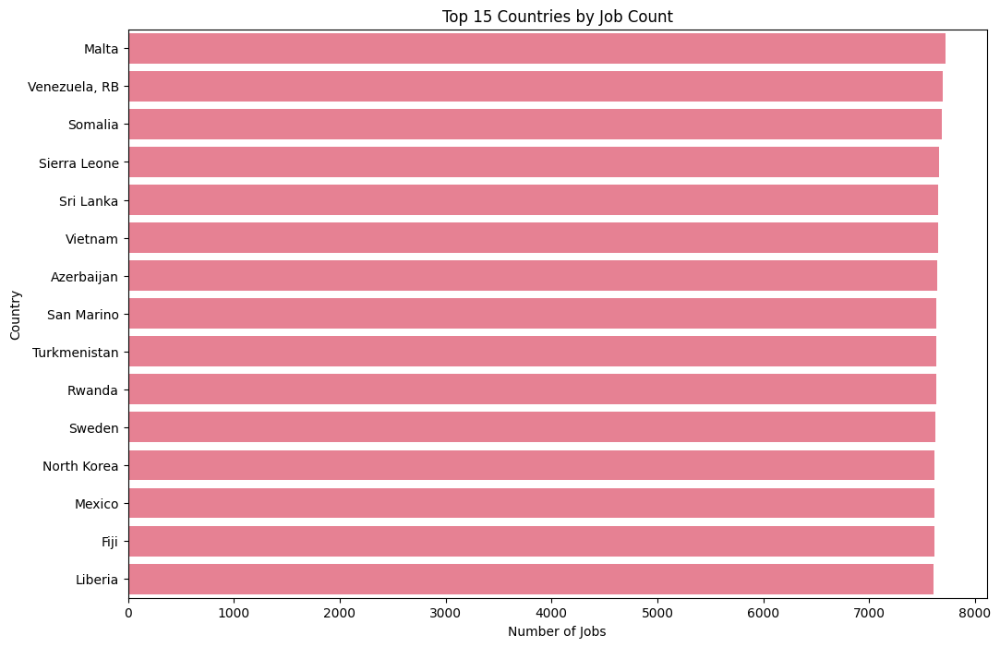

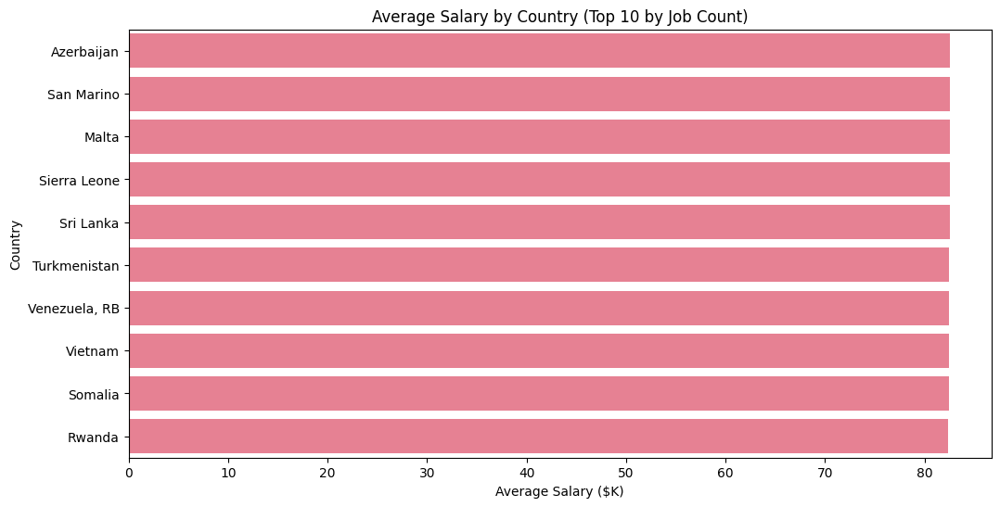

In [ ]:
# Cell 7: Geographical analysis
# Top countries by job count
country_counts = df['Country'].value_counts().head(15)

plt.figure(figsize=(12, 8))
sns.barplot(y=country_counts.index, x=country_counts.values)
plt.title('Top 15 Countries by Job Count')
plt.xlabel('Number of Jobs')
plt.ylabel('Country')
plt.show()

# Salary by country (top 10)
top_countries = df['Country'].value_counts().head(10).index
country_salary = df[df['Country'].isin(top_countries)].groupby('Country')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(y=country_salary.index, x=country_salary.values)
plt.title('Average Salary by Country (Top 10 by Job Count)')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Country')
plt.show()


In [ ]:
# Cell 8: World map visualization of jobs
# Create a world map showing job distribution
fig = px.scatter_geo(df,
                     lat='latitude',
                     lon='longitude',
                     color='Avg_Salary',
                     size='Avg_Salary',
                     hover_name='Job Title',
                     hover_data=['Company', 'Country', 'Avg_Salary'],
                     title='Global Distribution of Jobs by Salary',
                     projection='natural earth')
fig.show()


Buffered data was truncated after reaching the output size limit.

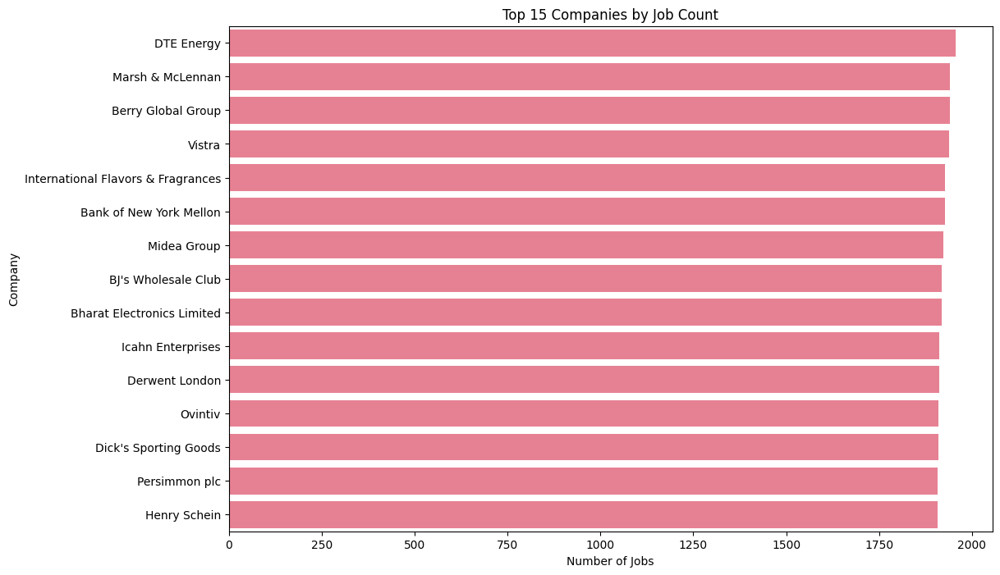

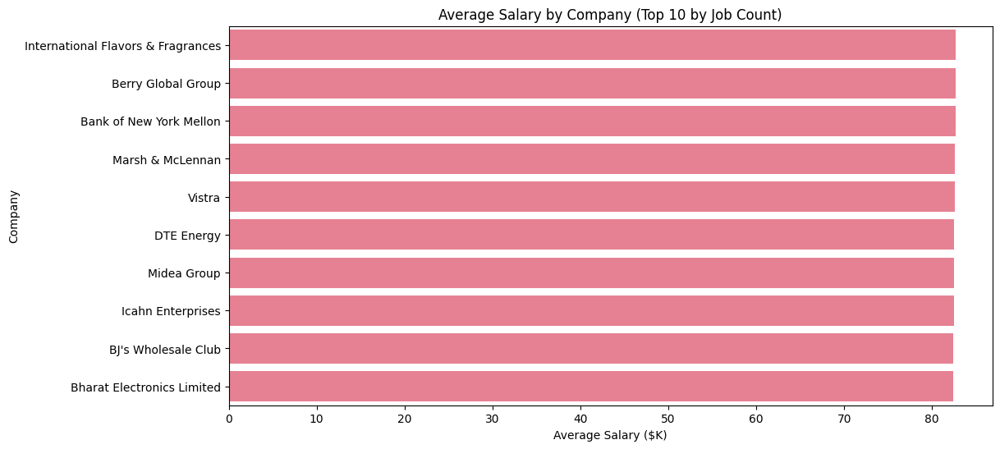

In [ ]:
# Cell 9: Company analysis
# Top companies by job count
company_counts = df['Company'].value_counts().head(15)

plt.figure(figsize=(12, 8))
sns.barplot(y=company_counts.index, x=company_counts.values)
plt.title('Top 15 Companies by Job Count')
plt.xlabel('Number of Jobs')
plt.ylabel('Company')
plt.show()

# Average salary by company (top 10)
top_companies = df['Company'].value_counts().head(10).index
company_salary = df[df['Company'].isin(top_companies)].groupby('Company')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(y=company_salary.index, x=company_salary.values)
plt.title('Average Salary by Company (Top 10 by Job Count)')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Company')
plt.show()


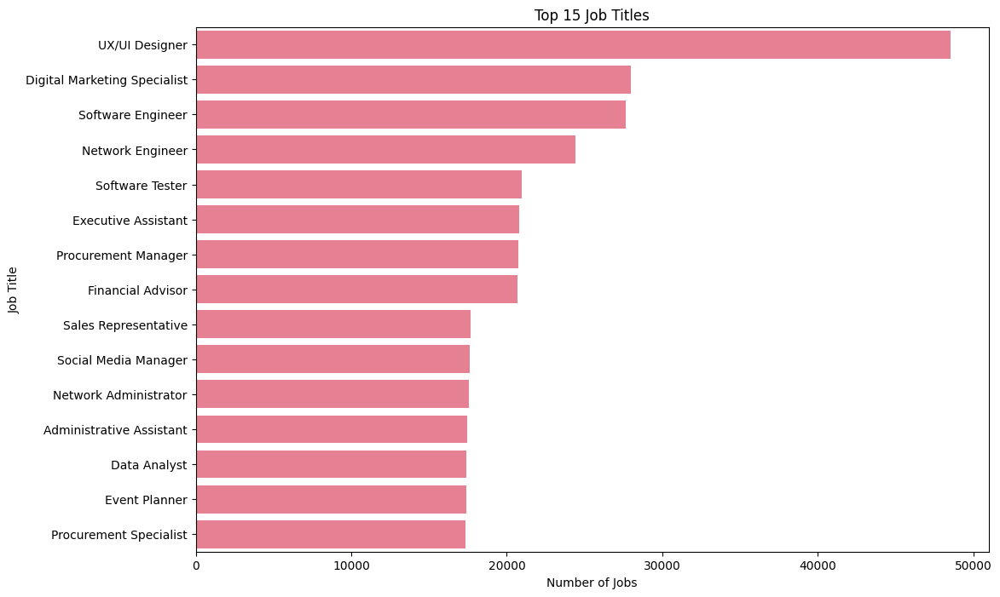

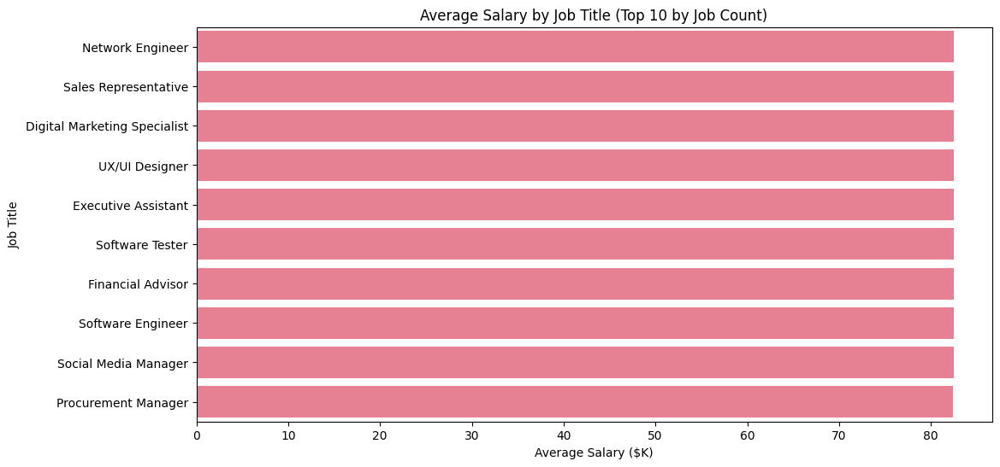

In [ ]:
# Cell 10: Job title analysis
# Top job titles
job_title_counts = df['Job Title'].value_counts().head(15)

plt.figure(figsize=(12, 8))
sns.barplot(y=job_title_counts.index, x=job_title_counts.values)
plt.title('Top 15 Job Titles')
plt.xlabel('Number of Jobs')
plt.ylabel('Job Title')
plt.show()

# Salary by job title (top 10)
top_titles = df['Job Title'].value_counts().head(10).index
title_salary = df[df['Job Title'].isin(top_titles)].groupby('Job Title')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(y=title_salary.index, x=title_salary.values)
plt.title('Average Salary by Job Title (Top 10 by Job Count)')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Job Title')
plt.show()


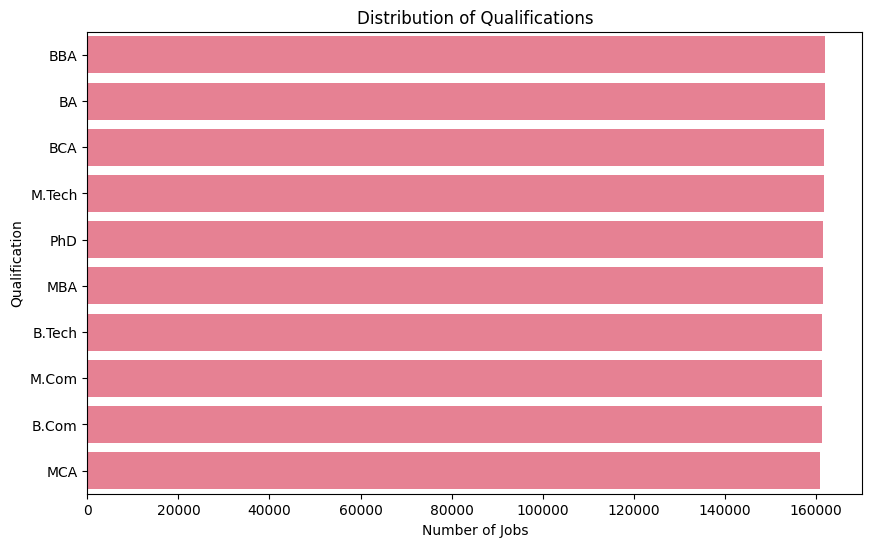

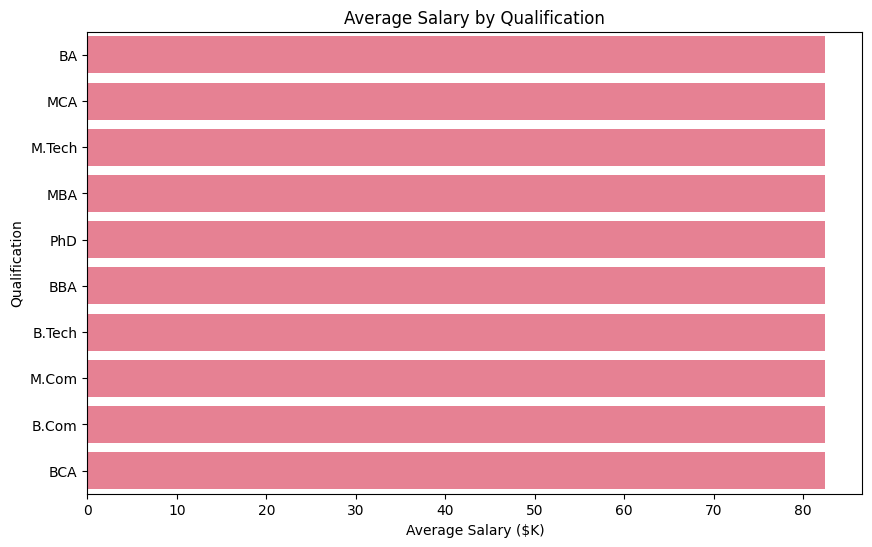

In [ ]:
# Cell 11: Qualifications analysis
# Distribution of qualifications
qualification_counts = df['Qualifications'].value_counts()

plt.figure(figsize=(10, 6))
sns.barplot(y=qualification_counts.index, x=qualification_counts.values)
plt.title('Distribution of Qualifications')
plt.xlabel('Number of Jobs')
plt.ylabel('Qualification')
plt.show()

# Salary by qualification
qualification_salary = df.groupby('Qualifications')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(y=qualification_salary.index, x=qualification_salary.values)
plt.title('Average Salary by Qualification')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Qualification')
plt.show()


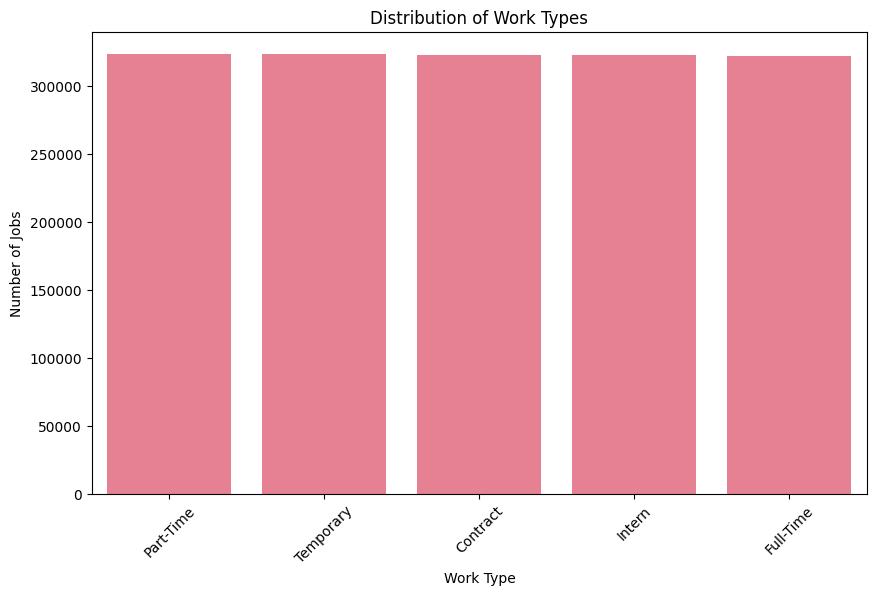

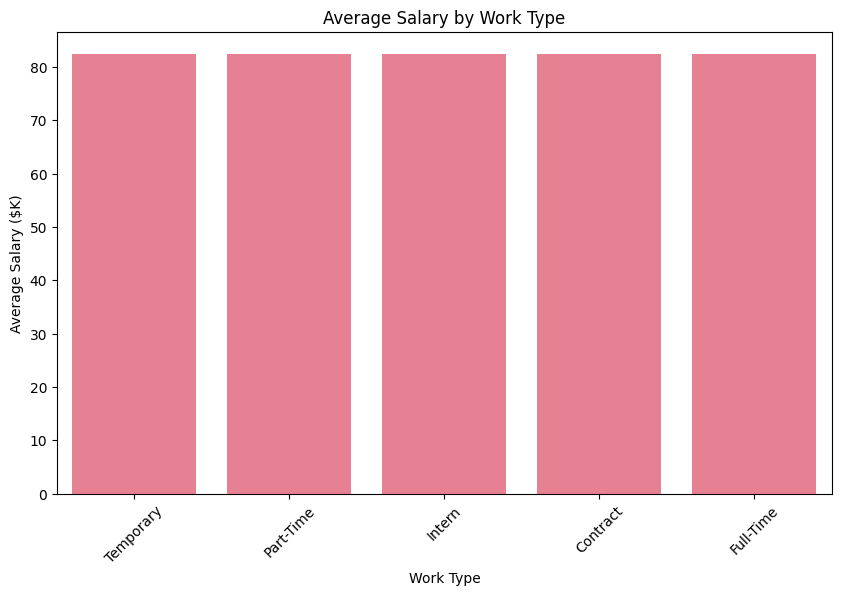

In [ ]:
# Cell 12: Work type analysis
# Distribution of work types
work_type_counts = df['Work Type'].value_counts()

plt.figure(figsize=(10, 6))
sns.barplot(x=work_type_counts.index, y=work_type_counts.values)
plt.title('Distribution of Work Types')
plt.xlabel('Work Type')
plt.ylabel('Number of Jobs')
plt.xticks(rotation=45)
plt.show()

# Salary by work type
work_type_salary = df.groupby('Work Type')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x=work_type_salary.index, y=work_type_salary.values)
plt.title('Average Salary by Work Type')
plt.xlabel('Work Type')
plt.ylabel('Average Salary ($K)')
plt.xticks(rotation=45)
plt.show()


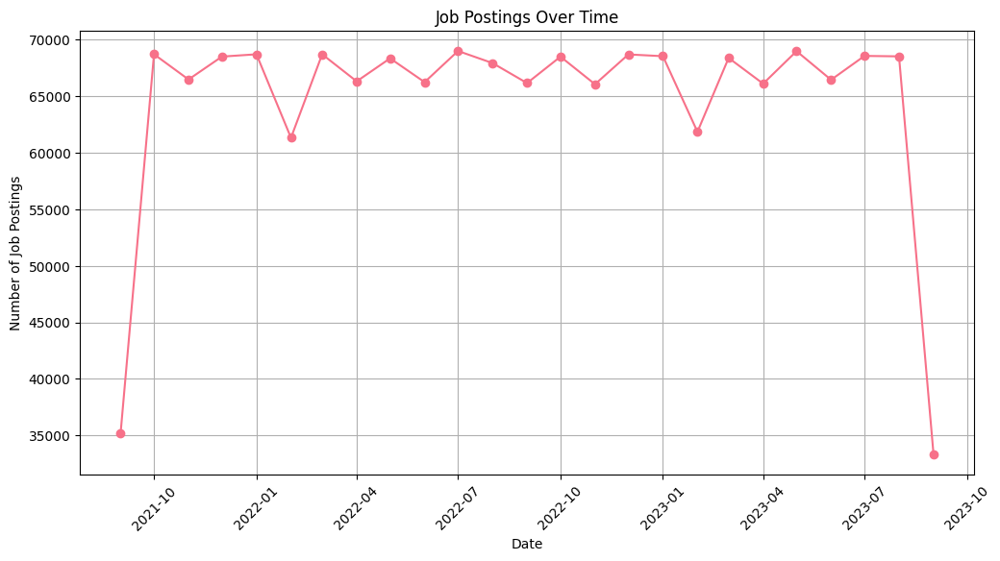

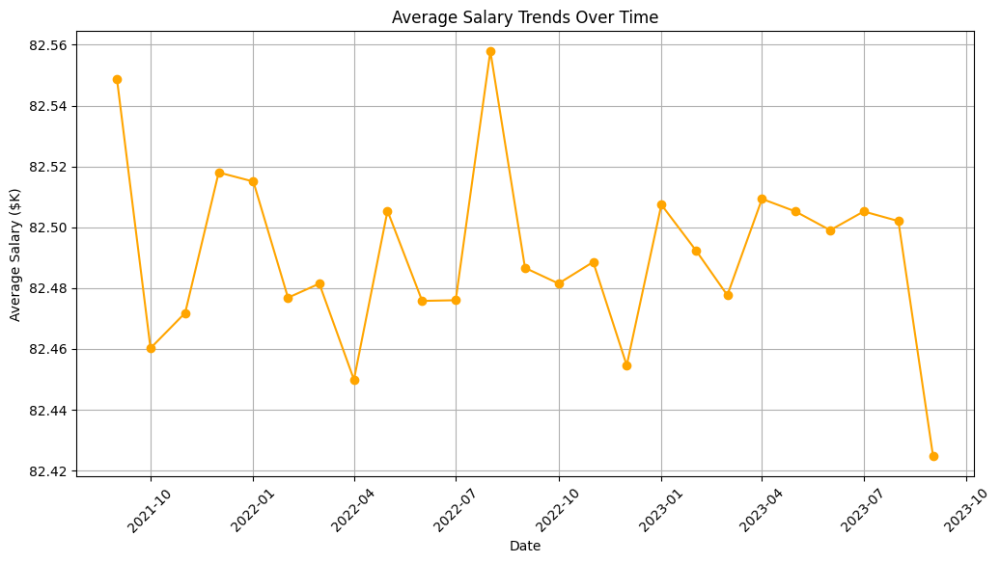

In [ ]:
# Cell 13: Temporal analysis
# Jobs over time
monthly_jobs = df.groupby(['Year', 'Month']).size().reset_index(name='Count')
monthly_jobs['Date'] = pd.to_datetime(monthly_jobs[['Year', 'Month']].assign(DAY=1))

plt.figure(figsize=(12, 6))
plt.plot(monthly_jobs['Date'], monthly_jobs['Count'], marker='o')
plt.title('Job Postings Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Job Postings')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

# Salary trends over time
monthly_salary = df.groupby(['Year', 'Month'])['Avg_Salary'].mean().reset_index()
monthly_salary['Date'] = pd.to_datetime(monthly_salary[['Year', 'Month']].assign(DAY=1))

plt.figure(figsize=(12, 6))
plt.plot(monthly_salary['Date'], monthly_salary['Avg_Salary'], marker='o', color='orange')
plt.title('Average Salary Trends Over Time')
plt.xlabel('Date')
plt.ylabel('Average Salary ($K)')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

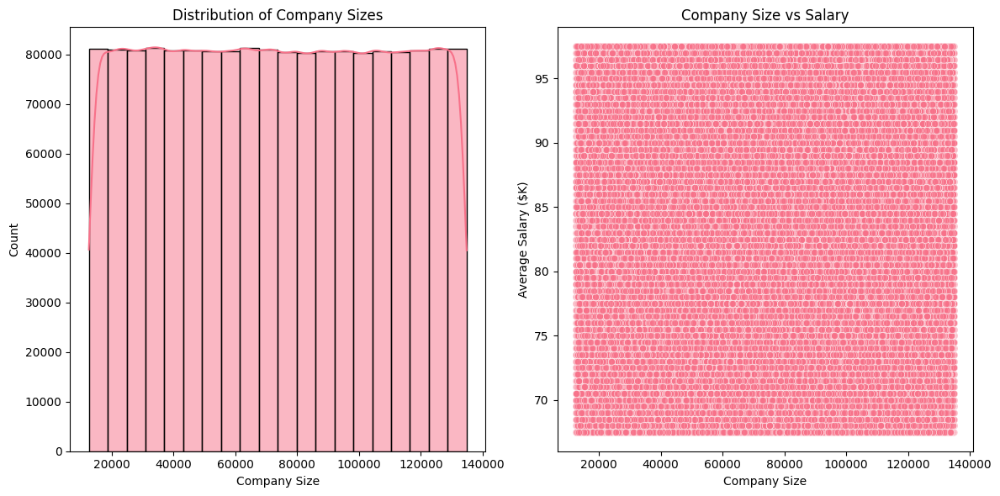

In [ ]:
# Cell 14: Company size analysis
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
sns.histplot(df['Company Size'], bins=20, kde=True)
plt.title('Distribution of Company Sizes')
plt.xlabel('Company Size')

plt.subplot(1, 2, 2)
sns.scatterplot(x='Company Size', y='Avg_Salary', data=df, alpha=0.6)
plt.title('Company Size vs Salary')
plt.xlabel('Company Size')
plt.ylabel('Average Salary ($K)')

plt.tight_layout()
plt.show()

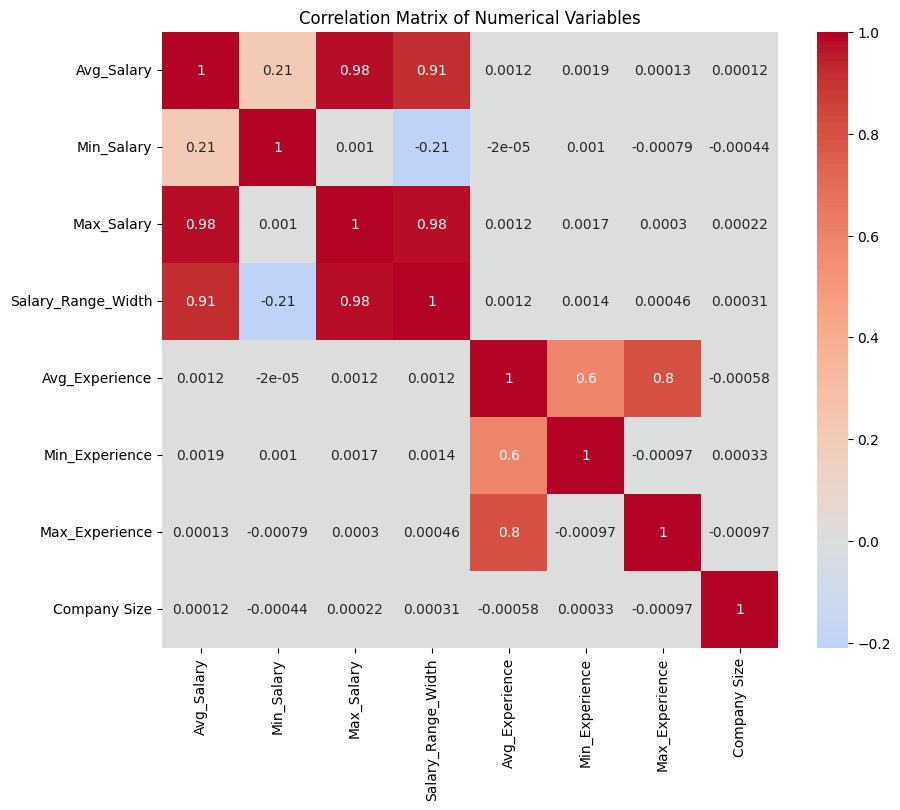

In [ ]:
# Cell 15: Correlation matrix
# Select numerical columns for correlation
numerical_cols = ['Avg_Salary', 'Min_Salary', 'Max_Salary', 'Salary_Range_Width',
                 'Avg_Experience', 'Min_Experience', 'Max_Experience', 'Company Size']

corr_matrix = df[numerical_cols].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, square=True)
plt.title('Correlation Matrix of Numerical Variables')
plt.show()

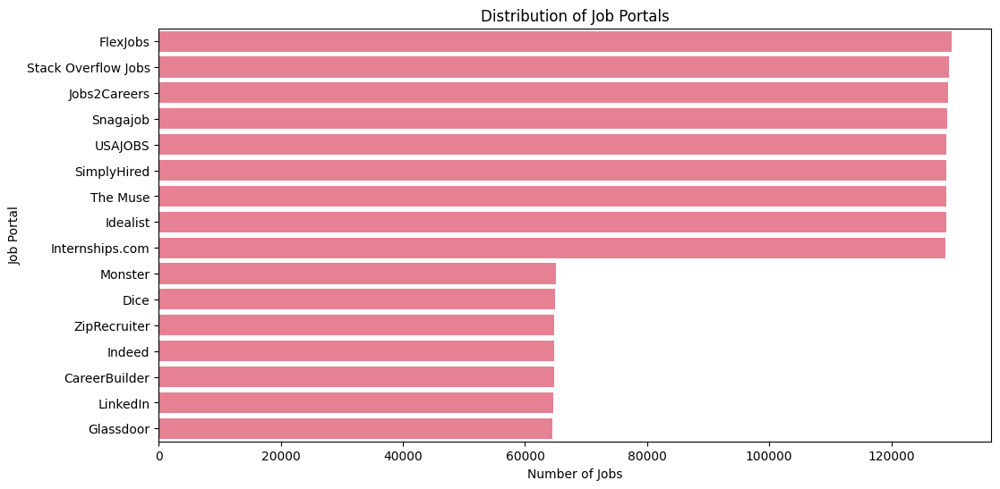

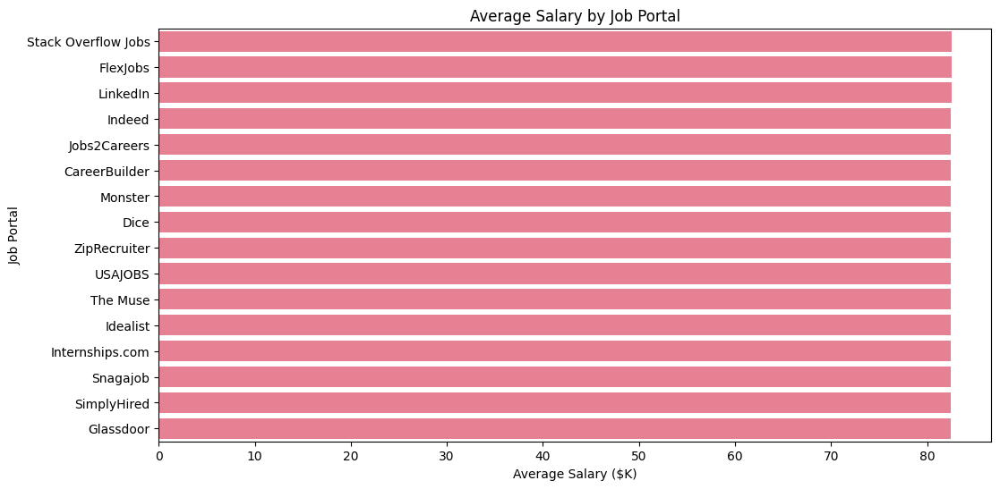

In [ ]:
# Cell 16: Job portal analysis
# Distribution of job portals
portal_counts = df['Job Portal'].value_counts()

plt.figure(figsize=(12, 6))
sns.barplot(y=portal_counts.index, x=portal_counts.values)
plt.title('Distribution of Job Portals')
plt.xlabel('Number of Jobs')
plt.ylabel('Job Portal')
plt.show()

# Average salary by job portal
portal_salary = df.groupby('Job Portal')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(y=portal_salary.index, x=portal_salary.values)
plt.title('Average Salary by Job Portal')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Job Portal')
plt.show()

In [ ]:
# Cell 17: Skills analysis (word cloud)
# Extract and clean skills data
all_skills = []
for skills in df['skills'].dropna():
    if isinstance(skills, str):
        # Clean the skills string
        skills = skills.replace('{', '').replace('}', '').replace("'", "")
        skills_list = [skill.strip() for skill in skills.split(',')]
        all_skills.extend(skills_list)

# Create word cloud
skills_text = ' '.join(all_skills)
wordcloud = WordCloud(width=800, height=400, background_color='white',
                      colormap='viridis', max_words=100).generate(skills_text)

plt.figure(figsize=(12, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Most Common Skills in Job Postings')
plt.show()

In [ ]:
# Cell 18: Role analysis
# Top roles
role_counts = df['Role'].value_counts().head(15)

plt.figure(figsize=(12, 8))
sns.barplot(y=role_counts.index, x=role_counts.values)
plt.title('Top 15 Roles')
plt.xlabel('Number of Jobs')
plt.ylabel('Role')
plt.show()

# Salary by role (top 10)
top_roles = df['Role'].value_counts().head(10).index
role_salary = df[df['Role'].isin(top_roles)].groupby('Role')['Avg_Salary'].mean().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(y=role_salary.index, x=role_salary.values)
plt.title('Average Salary by Role (Top 10 by Job Count)')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Role')
plt.show()

In [ ]:
# Cell 19: Interactive visualizations with Plotly
# Interactive salary distribution by country
fig = px.box(df, x='Country', y='Avg_Salary',
             title='Salary Distribution by Country',
             labels={'Avg_Salary': 'Average Salary ($K)', 'Country': 'Country'})
fig.update_layout(xaxis_tickangle=-45)
fig.show()

# Interactive experience vs salary
fig = px.scatter(df, x='Avg_Experience', y='Avg_Salary',
                 color='Work Type', size='Company Size',
                 hover_data=['Job Title', 'Company', 'Country'],
                 title='Experience vs Salary by Work Type')
fig.show()

Buffered data was truncated after reaching the output size limit.

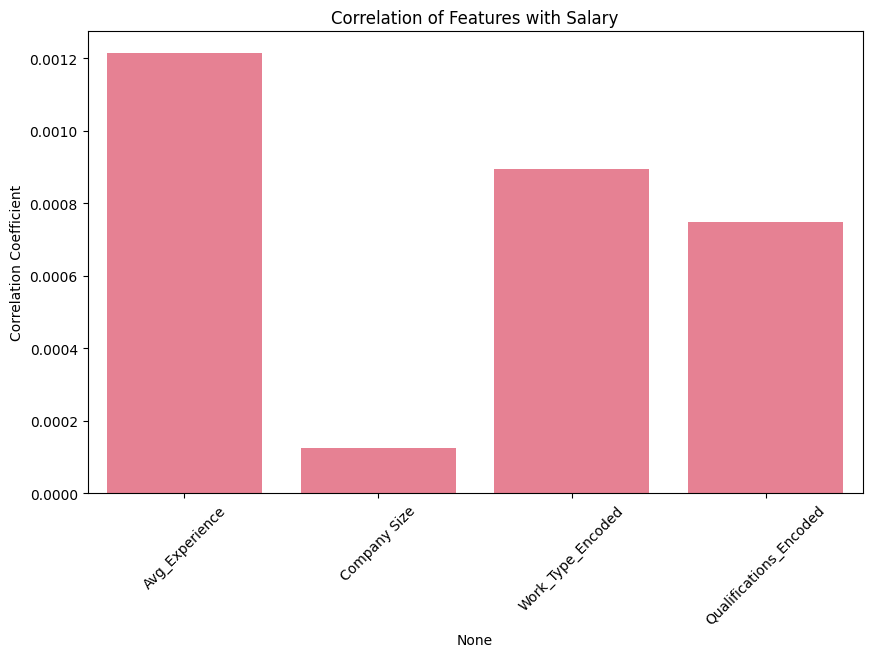

In [ ]:
# Cell 20: Advanced analysis - Salary prediction factors
# Prepare data for modeling
model_df = df[['Avg_Salary', 'Avg_Experience', 'Company Size', 'Work Type', 'Qualifications']].dropna()

# Encode categorical variables
le_work = LabelEncoder()
le_qual = LabelEncoder()

model_df['Work_Type_Encoded'] = le_work.fit_transform(model_df['Work Type'])
model_df['Qualifications_Encoded'] = le_qual.fit_transform(model_df['Qualifications'])

# Calculate correlations with salary
correlations = model_df[['Avg_Salary', 'Avg_Experience', 'Company Size',
                        'Work_Type_Encoded', 'Qualifications_Encoded']].corr()['Avg_Salary'].drop('Avg_Salary')

plt.figure(figsize=(10, 6))
sns.barplot(x=correlations.index, y=correlations.values)
plt.title('Correlation of Features with Salary')
plt.ylabel('Correlation Coefficient')
plt.xticks(rotation=45)
plt.show()

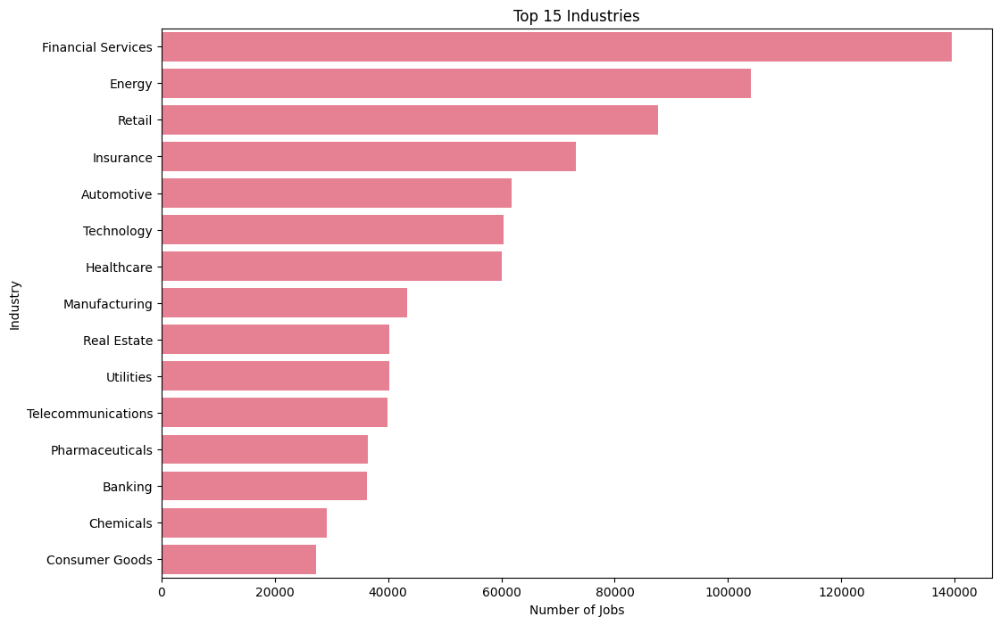

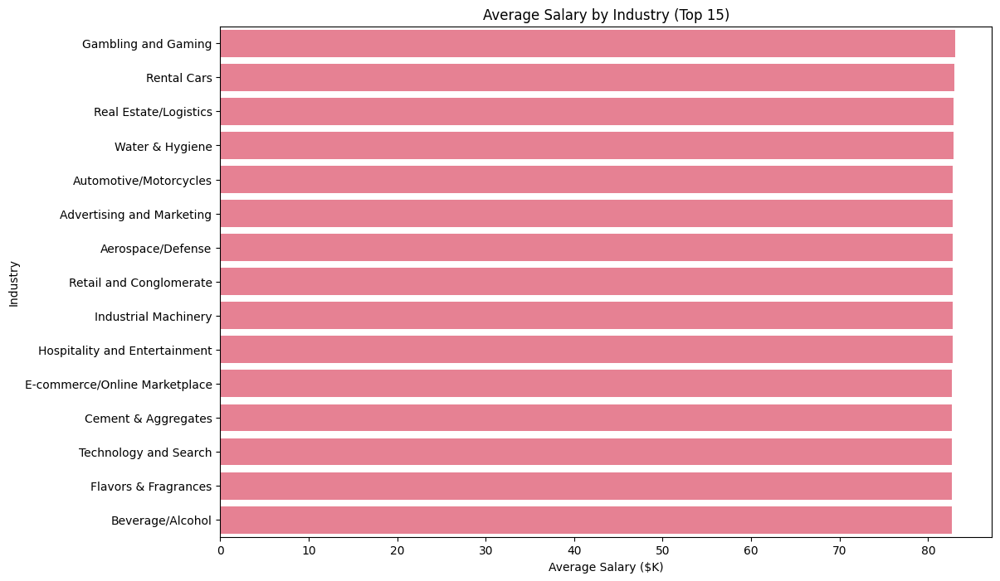

In [ ]:
# Cell 21: Industry/Sector analysis from Company Profile
# Extract industry from company profile (simplified)
def extract_industry(profile_str):
    try:
        if isinstance(profile_str, str):
            # Simple extraction - this could be enhanced
            if 'Sector' in profile_str:
                sector_part = profile_str.split('Sector')[1].split('Industry')[0]
                return sector_part.replace(':', '').replace('"', '').replace(',', '').strip()
    except:
        pass
    return 'Unknown'

df['Industry'] = df['Company Profile'].apply(extract_industry)

# Top industries
industry_counts = df['Industry'].value_counts().head(15)

plt.figure(figsize=(12, 8))
sns.barplot(y=industry_counts.index, x=industry_counts.values)
plt.title('Top 15 Industries')
plt.xlabel('Number of Jobs')
plt.ylabel('Industry')
plt.show()

# Salary by industry
industry_salary = df.groupby('Industry')['Avg_Salary'].mean().sort_values(ascending=False).head(15)

plt.figure(figsize=(12, 8))
sns.barplot(y=industry_salary.index, x=industry_salary.values)
plt.title('Average Salary by Industry (Top 15)')
plt.xlabel('Average Salary ($K)')
plt.ylabel('Industry')
plt.show()

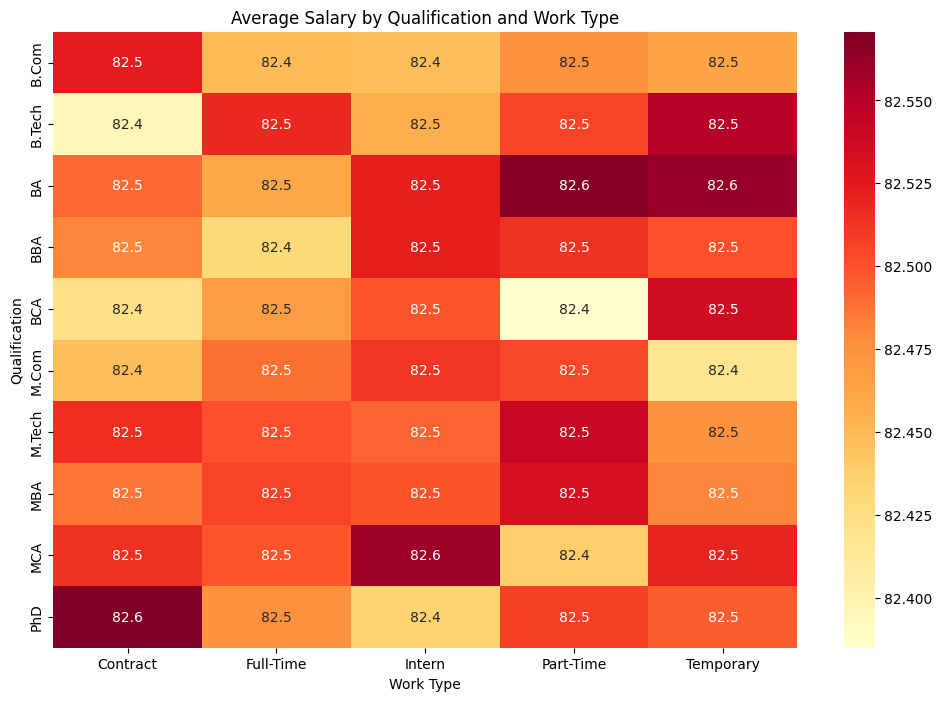

In [ ]:
# Cell 22: Multi-dimensional analysis
# Create a pivot table of average salary by work type and qualification
pivot_table = pd.pivot_table(df, values='Avg_Salary',
                            index='Qualifications',
                            columns='Work Type',
                            aggfunc='mean')

plt.figure(figsize=(12, 8))
sns.heatmap(pivot_table, annot=True, fmt='.1f', cmap='YlOrRd')
plt.title('Average Salary by Qualification and Work Type')
plt.xlabel('Work Type')
plt.ylabel('Qualification')
plt.show()

In [ ]:
# Cell 23: Advanced geographical analysis
# Create a chloropleth map of average salaries by country
country_avg_salary = df.groupby('Country')['Avg_Salary'].mean().reset_index()

fig = px.choropleth(country_avg_salary,
                    locations='Country',
                    locationmode='country names',
                    color='Avg_Salary',
                    hover_name='Country',
                    color_continuous_scale='Viridis',
                    title='Average Salary by Country')
fig.show()

In [ ]:
# Cell 24: Time series decomposition
from statsmodels.tsa.seasonal import seasonal_decompose

# Create monthly time series
monthly_ts = df.groupby(['Year', 'Month']).size()
monthly_ts.index = pd.to_datetime([f'{y}-{m}-01' for y, m in monthly_ts.index])

# Decompose time series
decomposition = seasonal_decompose(monthly_ts, model='additive', period=6)

plt.figure(figsize=(12, 8))
decomposition.plot()
plt.suptitle('Time Series Decomposition of Job Postings')
plt.tight_layout()
plt.show()

ModuleNotFoundError: No module named 'statsmodels'

In [ ]:
# Cell 25: Final summary statistics
print("FINAL SUMMARY STATISTICS")
print("=" * 50)
print(f"Total jobs analyzed: {len(df)}")
print(f"Time period: {df['Job Posting Date'].min().strftime('%Y-%m-%d')} to {df['Job Posting Date'].max().strftime('%Y-%m-%d')}")
print(f"Countries represented: {df['Country'].nunique()}")
print(f"Companies represented: {df['Company'].nunique()}")
print(f"Job titles: {df['Job Title'].nunique()}")
print(f"Average salary across all jobs: ${df['Avg_Salary'].mean():.2f}K")
print(f"Salary range: ${df['Min_Salary'].min():.2f}K - ${df['Max_Salary'].max():.2f}K")
print(f"Average experience required: {df['Avg_Experience'].mean():.2f} years")

# Most common work type
most_common_work = df['Work Type'].value_counts().idxmax()
print(f"Most common work type: {most_common_work}")

# Highest paying qualification
highest_paying_qual = df.groupby('Qualifications')['Avg_Salary'].mean().idxmax()
print(f"Highest paying qualification: {highest_paying_qual} (${df.groupby('Qualifications')['Avg_Salary'].mean().max():.2f}K)")

# Country with most jobs
most_jobs_country = df['Country'].value_counts().idxmax()
print(f"Country with most jobs: {most_jobs_country}")

# Company with most postings
most_postings_company = df['Company'].value_counts().idxmax()
print(f"Company with most postings: {most_postings_company}")